# Springback UV map

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 120

from cut_predictor import ProjectionPredictor

In [2]:
doe = pd.read_csv('../data/doe.csv')
doe

,doe_id,Material_ID,Blechdicke,Niederhalterkraft,Ziehspalt,Stempel_ID,Einlegeposition,Ziehtiefe,Breite,UG,OG,E,Material_Name,Rp0,Rp0.2,Rp100,Rp25,Rp50
0,1,3,1.01,410,2.4,3,-5,30,70.2,1.71,2.00,191.37245,DC04_1.00mm,138.226960,147.601859,534.002871,377.443009,449.528189
1,2,5,1.48,400,2.4,3,-4,50,70.2,1.71,2.00,71.68198,AA5083_1.50mm,235.160326,237.951493,384.123147,369.820589,383.041834
2,3,1,1.00,210,2.4,3,-1,70,70.2,1.71,2.00,164.62254,DC01_1.00mm,133.182632,147.101263,517.275855,385.773439,447.384736
3,4,2,1.19,390,2.4,3,5,30,70.2,1.71,2.00,200.03813,DC01_1.20mm,160.714935,174.535075,564.455438,424.931018,490.442223
4,5,1,1.00,360,1.6,2,3,30,71.8,1.14,1.33,164.62254,DC01_1.00mm,133.182632,147.101263,517.275855,385.773439,447.384736
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,3,1.01,90,1.6,2,0,70,71.8,1.14,1.33,191.37245,DC04_1.00mm,138.226960,147.601859,534.002871,377.443009,449.528189
996,997,4,0.99,480,2.4,3,5,30,70.2,1.71,2.00,71.94184,AA5083_1.00mm,248.796491,251.315902,385.373316,371.774337,384.299873
997,998,5,1.48,490,2.4,3,3,50,70.2,1.71,2.00,71.68198,AA5083_1.50mm,235.160326,237.951493,384.123147,369.820589,383.041834
998,999,5,1.48,120,2.4,3,-3,30,70.2,1.71,2.00,71.68198,AA5083_1.50mm,235.160326,237.951493,384.123147,369.820589,383.041834


In [3]:
data = pd.read_csv('../data/springback_uvmap.csv')
data.drop(data[data.doe_id == 1000].index, inplace=True)
data.drop(data[data.doe_id == 247].index, inplace=True)
data

,doe_id,u,v,x,y,z,thickness,epseqpl,thinning
0,1,0.000000,0.000000,-132.603620,-117.544130,0.895656,1.000417,0.000823,0.990512
1,1,0.500000,0.019171,-0.000088,-87.060616,0.489975,0.991176,0.010210,0.981363
2,1,1.000000,0.036529,137.002380,-104.238950,0.742256,1.000619,0.001208,0.990712
3,1,1.000000,0.000000,132.603620,-117.544130,0.895656,1.000417,0.000823,0.990512
4,1,0.500000,0.000000,-0.000141,-95.070107,0.536487,0.992336,0.007779,0.982511
...,...,...,...,...,...,...,...,...,...
16721570,998,0.254233,0.654230,-89.967537,28.110500,35.537619,1.354696,0.277900,0.915335
16721571,998,0.255316,0.641760,-89.548157,28.170677,37.664772,1.345915,0.279300,0.909402
16721572,998,0.255497,0.628215,-89.451439,28.237469,39.968052,1.340451,0.279300,0.905710
16721573,998,0.254664,0.617541,-89.724800,28.299198,41.775429,1.393057,0.217900,0.941255


In [4]:
reg = ProjectionPredictor()
reg.load_data(
    doe = doe,
    data = data,
    index='doe_id',
    process_parameters = [
        'Blechdicke', 
        'Niederhalterkraft', 
        'Ziehspalt', 
        'Einlegeposition', 
        'Ziehtiefe',
        'Stempel_ID',
    ],
    categorical = [
        'Ziehspalt', 
        'Ziehtiefe',
        'Stempel_ID',
    ],
    position = ['u', 'v'],
    output = ['x', 'y', 'z'] #, 'thickness', 'epseqpl', 'thinning']
)

In [5]:
reg.data_summary()

Data summary
------------------------------------------------------------

Process parameters:
	- Blechdicke : numerical [ 0.99  ...  1.48 ]
	- Niederhalterkraft : numerical [ 10  ...  500 ]
	- Ziehspalt : categorical [1.6, 2.4]
	- Einlegeposition : numerical [ -5  ...  5 ]
	- Ziehtiefe : categorical [30, 50, 70]
	- Stempel_ID : categorical [2, 3]
Input variables:
	- u : numerical, [ 0.0 / 1.0 ] 
	- v : numerical, [ 0.0 / 1.0 ] 
Output variable(s):
	- x : numerical, [ -202.42731 / 202.42731 ]
	- y : numerical, [ -118.32256 / 96.918961 ]
	- z : numerical, [ 0.0 / 73.213165 ]

Inputs
------------------------------------------------------------

(16697652, 12)

Outputs
------------------------------------------------------------

(16697652, 3)


Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               3328      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 256)               65792     
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 256)               0         
                                         

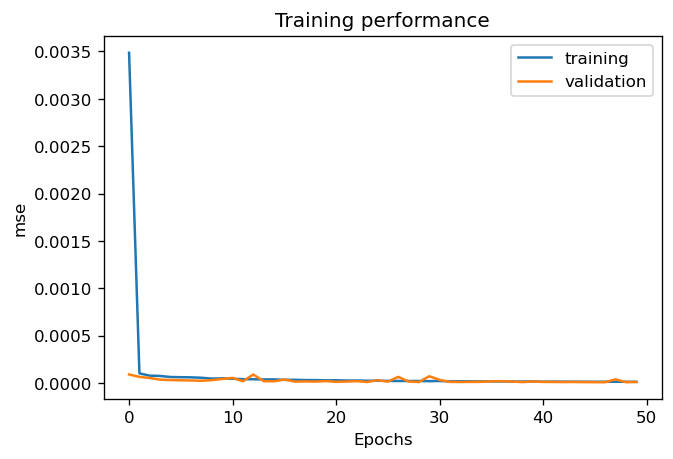

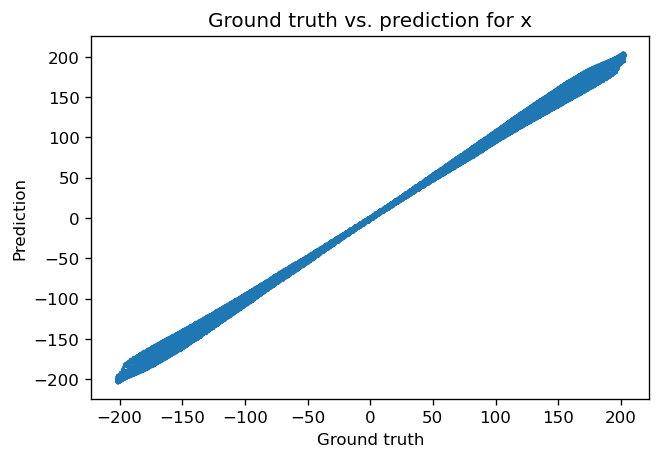

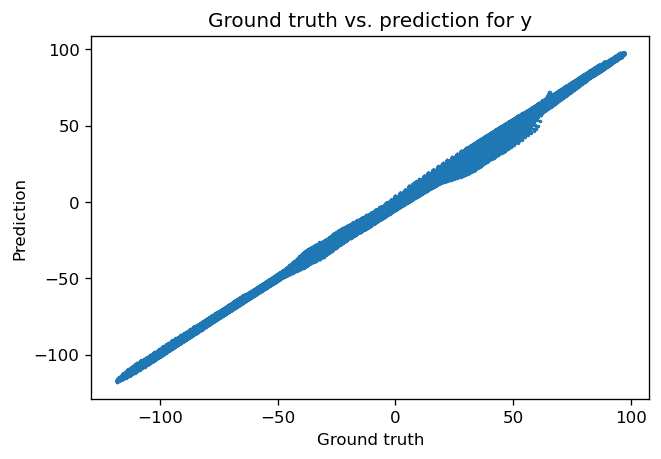

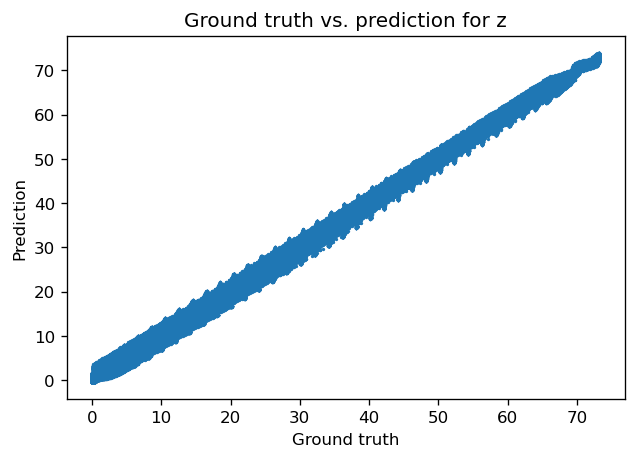

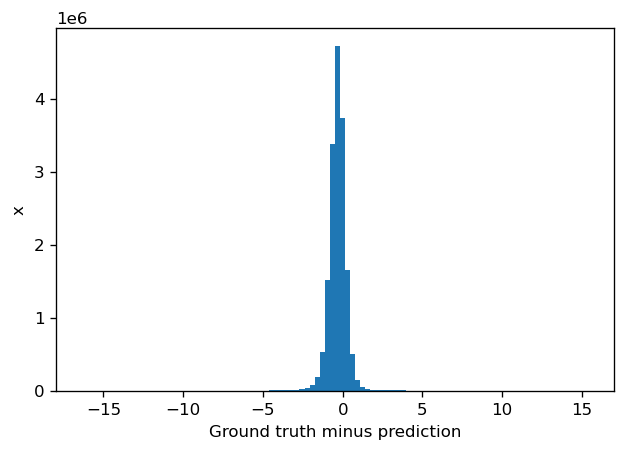

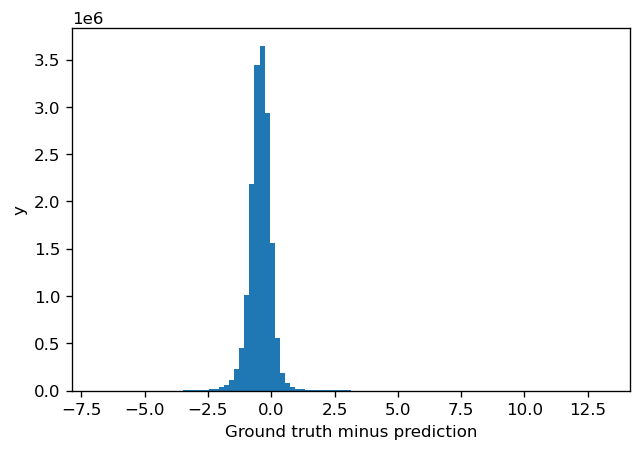

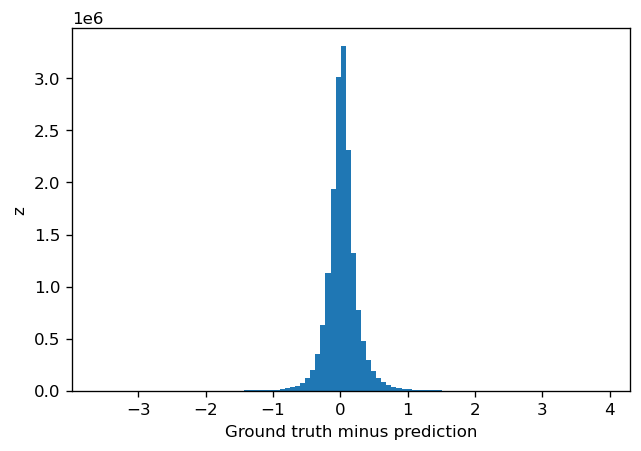

In [6]:
config = {
    'batch_size': 2048*16,
    'max_epochs': 50,
    'layers': [256, 256, 256, 256, 256],
    'dropout': 0.0,
    'learning_rate': 0.001,
    'activation': 'lrelu'
}

reg.custom_model(save_path='models/best_uv_model', config=config, verbose=True)
reg.training_summary()

In [6]:
reg.load_network('models/best_uv_model')

Metal device set to: Apple M1 Pro


Doe_ID 439


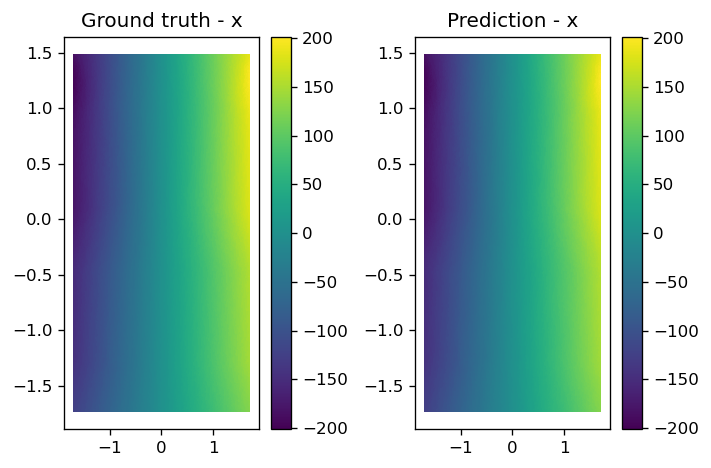

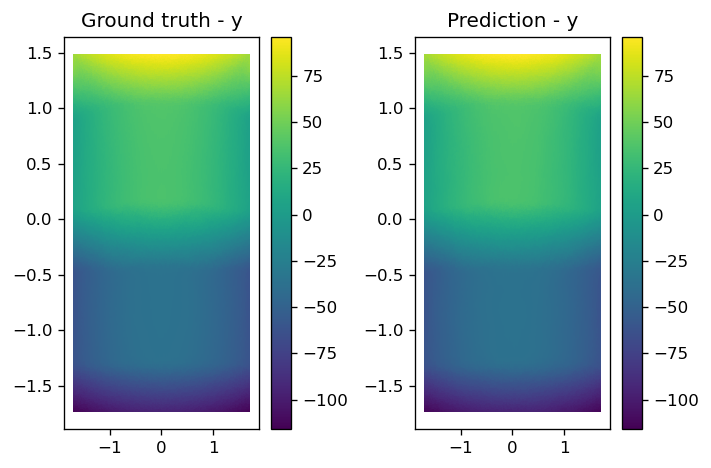

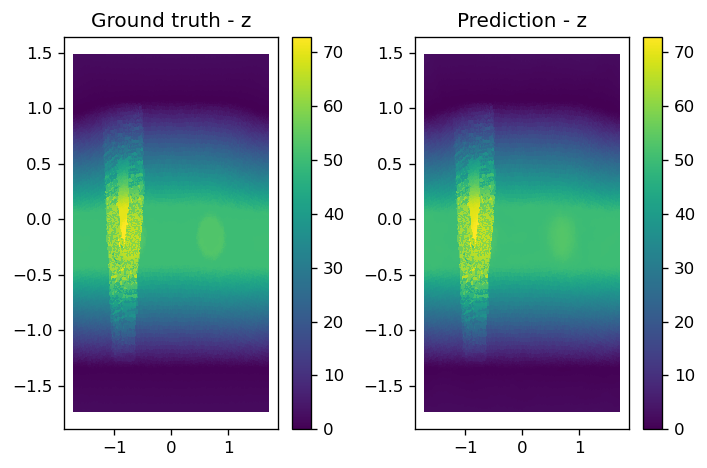

In [7]:
idx = np.random.choice(data['doe_id'].unique()) 
print("Doe_ID", idx)
reg.compare(idx)

In [11]:
x, y = reg.predict({
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 410.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 138.22696,
        'Rp50': 449.528189,
    }, 
    shape=(500, 500))

import plotly
import plotly.graph_objs as go
plotly.offline.init_notebook_mode()

def show_surface(x, y):
    # Configure the trace.
    trace = go.Scatter3d(
        x=y[0, :, :].flatten(),  
        y=y[1, :, :].flatten(),
        z=y[2, :, :].flatten(),
        mode='markers',
        marker={
            'size': 0.2,
            'opacity': 0.8,
        }
    )

    # Configure the layout.
    layout = go.Layout(
        margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
    )

    data = [trace]

    plot_figure = go.Figure(data=data, layout=layout)

    # Render the plot.
    plotly.offline.iplot(plot_figure)

show_surface(x, y)


In [12]:
reg.interactive(show_surface, shape=(500, 500))

interactive(children=(FloatSlider(value=1.1883700000000001, description='Blechdicke', max=1.48, min=0.99, step…